In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!unzip -q "/content/drive/MyDrive/TCC/bueiro_dataset3.zip" -d /content

In [4]:
!git clone https://github.com/ultralytics/yolov5
%cd yolov5
!pip install -r requirements.txt

Cloning into 'yolov5'...
remote: Enumerating objects: 17488, done.
remote: Counting objects: 100% (5/5), done.
remote: Compressing objects: 100% (5/5), done.
remote: Total 17488 (delta 0), reused 1 (delta 0), pack-reused 17483 (from 1)
Receiving objects: 100% (17488/17488), 16.59 MiB | 23.43 MiB/s, done.
Resolving deltas: 100% (11991/11991), done.
/content/yolov5
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 1.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 73.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 61.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 867.5 kB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 10.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.6 MB/s eta 0:0

In [ ]:
import os

intervalo_min = 10  # tempo entre backups (em minutos)

script = f"""
while true
do
  exp_dir=$(ls -td /content/runs/train/*/ | head -1)
  if [ -f "$exp_dir/weights/last.pt" ]; then
    cp "$exp_dir/weights/last.pt" /content/drive/MyDrive/TCC/last_backup.pt
    echo "✔️ last.pt salvo em $(date)"
  fi
  if [ -f "$exp_dir/weights/best.pt" ]; then
    cp "$exp_dir/weights/best.pt" /content/drive/MyDrive/TCC/best_backup.pt
    echo "✔️ best.pt salvo em $(date)"
  fi
  sleep {intervalo_min * 60}
done
"""

with open("backup_loop.sh", "w") as f:
    f.write(script)

os.system("nohup bash backup_loop.sh &")
print("🔁 Backup automático ativado em segundo plano!")

🔁 Backup automático ativado em segundo plano!


In [9]:
!python train.py \
  --img 640 \
  --batch 16 \
  --epochs 20 \
  --data /content/bueiro_dataset3/data.yaml \
  --weights /content/drive/MyDrive/TCC/last.pt \
  --name exp \
  --save-period 5 \
  --patience 20

# !python train.py \
#   --img 640 \
#   --batch 16 \
#   --epochs 20 \
#   --data /content/bueiro_dataset3/data.yaml \
#   --weights /content/yolov5/runs/train/bueiro_duas_classes_seguro2/weights/last.pt \
#   --name exp \
#   --patience 20 \
#   --save-period 5

wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-06-06 12:30:39.950528: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749213039.989347    7894 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749213040.006300    7894 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 3
wandb: You chose "Don't visualize my results"
train: weights=/content/drive/MyDrive/TCC/last.pt, cfg=, data=/content/bu

In [10]:
!python train.py --resume


wandb: WARNING ⚠️ wandb is deprecated and will be removed in a future release. See supported integrations at https://github.com/ultralytics/yolov5#integrations.
2025-06-06 13:36:49.790663: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1749217010.136255   23849 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1749217010.230125   23849 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: (30 second timeout) 3
wandb: You chose "Don't visualize my results"
train: weights=yolov5s.pt, cfg=, data=data/coco128.yaml, hyp=data/hyps/hy

In [11]:
%load_ext tensorboard
%tensorboard --logdir /content/yolov5/runs/train/exp4


<IPython.core.display.Javascript object>

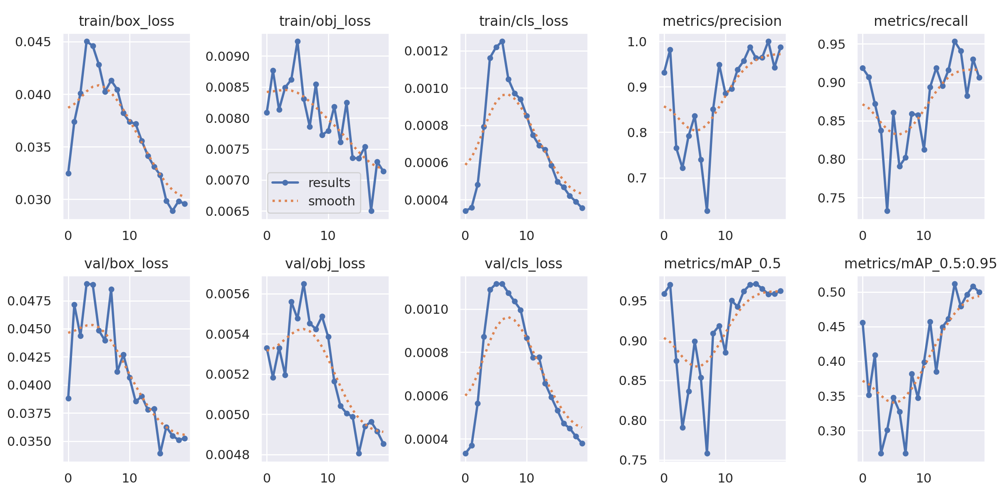

In [12]:
from IPython.display import Image
Image(filename='/content/yolov5/runs/train/exp4/results.png')


In [16]:
!python detect.py \
  --weights /content/yolov5/runs/train/exp4/weights/best.pt \
  --img 640 \
  --conf 0.25 \
  --source /content/drive/MyDrive/TCC/teste2.jpg

detect: weights=['/content/yolov5/runs/train/exp4/weights/best.pt'], source=/content/drive/MyDrive/TCC/teste2.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-420-g0c99ce80 Python-3.11.13 torch-2.6.0+cu124 CPU

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/drive/MyDrive/TCC/teste2.jpg: 640x480 1 bueiro, 503.6ms
Speed: 2.3ms pre-process, 503.6ms inference, 1.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3


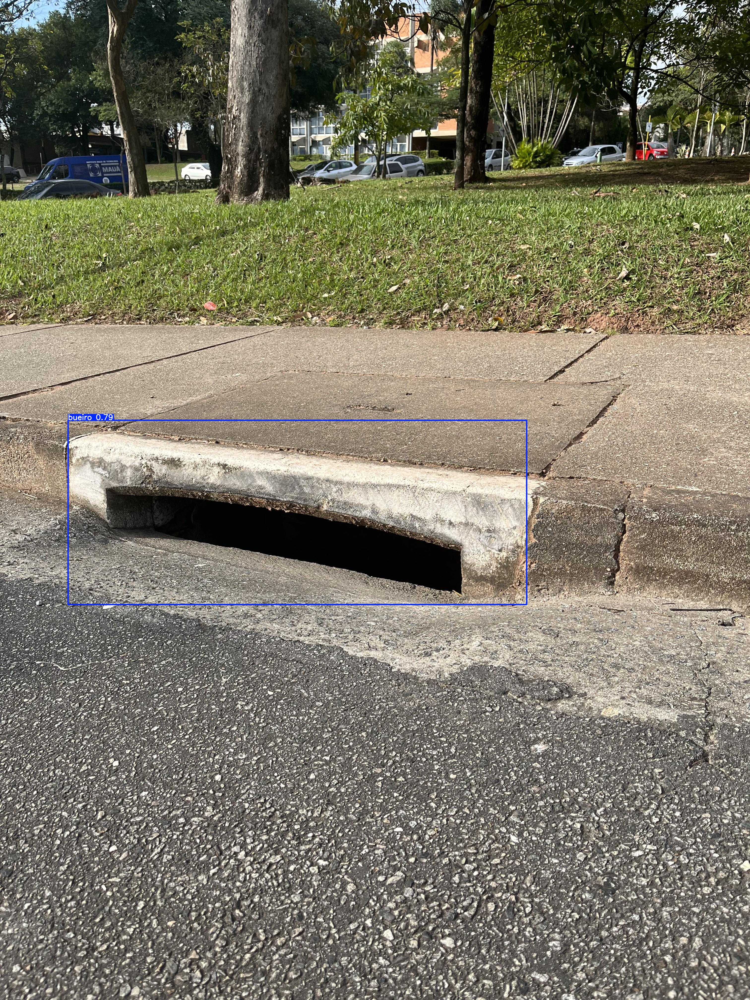

In [17]:
from IPython.display import Image, display
display(Image(filename='/content/yolov5/runs/detect/exp3/teste2.jpg'))


In [18]:
!python detect.py \
  --weights /content/yolov5/runs/train/exp4/weights/best.pt \
  --img 640 \
  --conf 0.25 \
  --source /content/drive/MyDrive/TCC/teste3.jpg

detect: weights=['/content/yolov5/runs/train/exp4/weights/best.pt'], source=/content/drive/MyDrive/TCC/teste3.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-420-g0c99ce80 Python-3.11.13 torch-2.6.0+cu124 CPU

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/drive/MyDrive/TCC/teste3.jpg: 640x480 1 bueiro, 295.4ms
Speed: 1.6ms pre-process, 295.4ms inference, 1.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp4


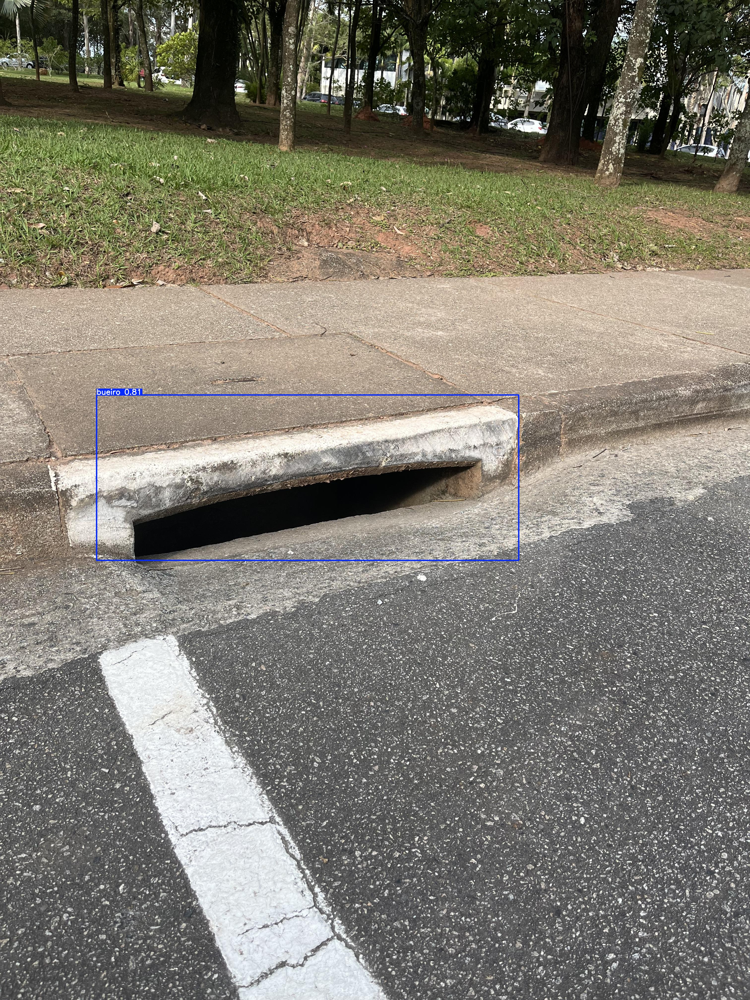

In [19]:
from IPython.display import Image, display
display(Image(filename='/content/yolov5/runs/detect/exp4/teste3.jpg'))

In [20]:
!python detect.py \
  --weights /content/yolov5/runs/train/exp4/weights/best.pt \
  --img 640 \
  --conf 0.25 \
  --source /content/drive/MyDrive/TCC/teste4.jpg

detect: weights=['/content/yolov5/runs/train/exp4/weights/best.pt'], source=/content/drive/MyDrive/TCC/teste4.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_format=0, save_csv=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-420-g0c99ce80 Python-3.11.13 torch-2.6.0+cu124 CPU

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/1 /content/drive/MyDrive/TCC/teste4.jpg: 640x480 3 bueiros, 353.8ms
Speed: 2.9ms pre-process, 353.8ms inference, 1.2ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp5


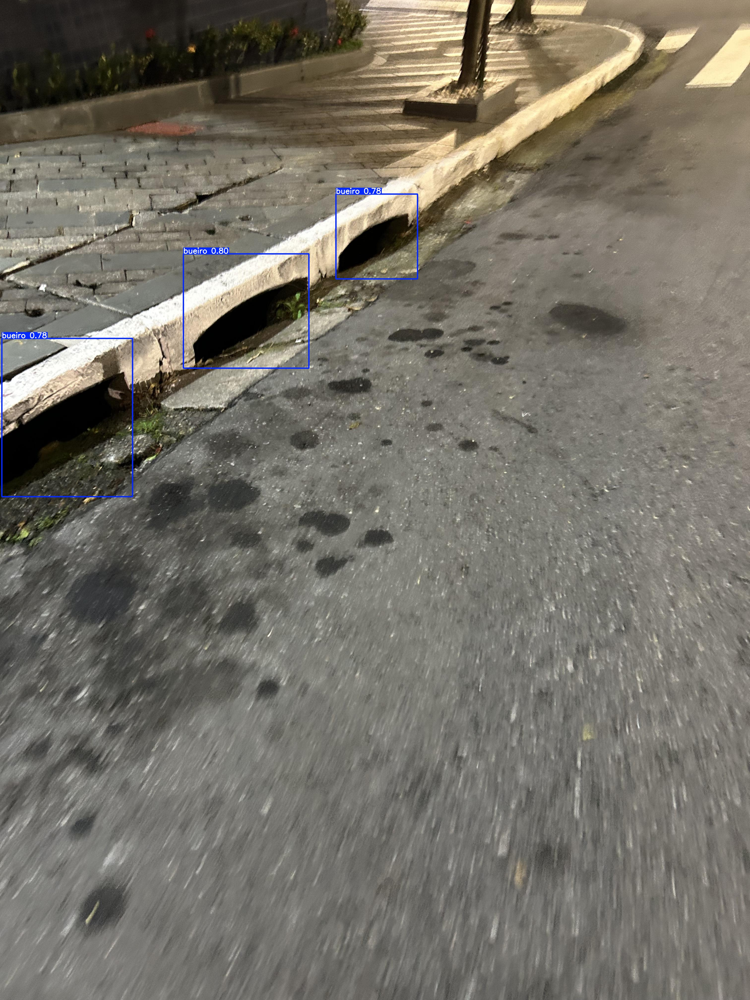

In [21]:
from IPython.display import Image, display
display(Image(filename='/content/yolov5/runs/detect/exp5/teste4.jpg'))